# Simulation of Φ-sat-2 bands from Sentinel-2 bands

This notebook implements the simulation chain to derive Φ-sat-2 bands starting from Sentinel-2 L1C images. The processing chain is outlined in the _Phisat-2 Mission Overview_ document. 

The aim of this challenge is to create an AI-based application that will be deployed on board of the Φ-sat-2 satellite. In order to train your AI-based models, we simulate Φ-sat-2 imagery starting from Sentinel-2 imagery, which are spectrally very similar. This notebook will allow you to simulate Φ-sat-2 images starting from the entire archive of Sentinel-2 imagery available through Sentinel Hub. In addition, we provide a pre-computed dataset of about 500 Φ-sat-2 images. Checkout [Section 13](#core-dataset) for more information about the core dataset was generated.

This notebook showcases how to download and simulate the data using [eo-learn](https://eo-learn.readthedocs.io/en/latest/index.html), a Python library specifically designed to deal with Earth Observation data. The data will be stored into EOPatches as numpy arrays and geopandas dataframes to facilitate processing operations. The output imagery is by default saved in the GeoTiff file format.

The simulation workflow can be summarised as follows:

 * download Sentinel-2 L1C bands (`B02`, `B03`, `B04`, `B08`, `B05`, `B06`, `B07`) and the Scene Classification `SCL` mask. More details about the bands can be found at [this link](https://docs.sentinel-hub.com/api/latest/data/sentinel-2-l1c/#available-bands-and-data);
 * create the cloud, cloud shadow and cirrus masks as separate arrays;
 * (optional) filter time-frames by data coverage;
 * download metadata about solar irradiance and Earth-Sun distance;
 * compute radiances from reflectances;
 * compute a pan-chromatic as linear combination of the input bands;
 * spatial resampling to Φ-sat-2 pixel size;
 * simulate L1A/L1B band-to-band misalignment;
 * simulate signal degradation due to Signal-to-Noise Ratio (SNR);
 * simulate signal degradation due to Module Transfer Function (MTF);
 * for L1C, simulate reflectances from radiance values;
 * split the AOI into a smaller set of image chips;
 * save bands and masks for the image chips to generate an AI-ready dataset.

Content of the notebook is as follows:

0. [Requirements](#requirements)
1. [Data Download](#data-download)
2. [Metadata Download](#metadata-download)
3. [Compute Radiances](#radiances)
4. [Add Pan-chromatic Band](#pan-band)
5. [Spatial Resampling](#resampling)
6. [Band Misalignment](#misalignment)
7. [Noise Calculation](#snr)
8. [Simulate PSF Filtering](#psf)   
9. [Alternative Noise and PSF filtering calculation](#alternative)    
10. [Compute L1C](#l1c)
11. [Gridding](#gridding)
12. [Export to Tiff](#export)
13. [Create Workflow](#workflow)
14. [Core Dataset](#core-dataset)

To run the notebook, install the Python libraries listed in the provided `requirements.txt` file, for instance by running `pip install-r requirements.txt`.

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import datetime
import os

import matplotlib.pyplot as plt
import cv2
import numpy as np
import geopandas as gpd
from eolearn.core import (
    EOTask, 
    EOPatch,
    EOWorkflow,
    FeatureType,
    MapFeatureTask,
    RemoveFeatureTask,
    linearly_connect_tasks,
    EOExecutor,
)
from eolearn.features import SimpleFilterTask
from eolearn.io import SentinelHubInputTask
from eolearn.features.utils import spatially_resize_image as resize_images
from sentinelhub import (
    BBox,
    DataCollection,
    SHConfig,
    get_utm_crs,
    wgs84_to_utm,
)
from sentinelhub.exceptions import SHDeprecationWarning
from tqdm.auto import tqdm

from phisat2_constants import (
    S2_BANDS,
    S2_RESOLUTION,
    BBOX_SIZE,
    PHISAT2_RESOLUTION,
    ProcessingLevels,
    WORLD_GDF,
)
from phisat2_utils import (
    AddPANBandTask,
    AddMetadataTask,
    CalculateRadianceTask,
    CalculateReflectanceTask,
    SCLCloudTask,
    BandMisalignmentTask,
    PhisatCalculationTask,
    AlternativePhisatCalculationTask,
    CropTask,
    GriddingTask,
    ExportGridToTiff,
    get_extent,
)

/home/ccollado/miniconda3/envs/phileo_env/lib/python3.9/site-packages/eolearn/io/sentinelhub_process.py:36: SHDeprecationWarning: The module `sentinelhub.type_utils` is deprecated, use `sentinelhub.types` instead.
  from sentinelhub.type_utils import RawTimeIntervalType
/home/ccollado/miniconda3/envs/phileo_env/lib/python3.9/abc.py:106: SHDeprecationWarning: AWS functionality will remain in the codebase for now, but won't be actively maintained.
  cls = super().__new__(mcls, name, bases, namespace, **kwargs)


In [3]:
# filter out some SHDeprecationWarnings
import warnings

warnings.filterwarnings("ignore", category=SHDeprecationWarning)

<a name="requirements"></a>
## 0. Requirements 

In order to download the training data through the provided APIs you would need to set-up an account for [Sentinel Hub](https://www.sentinel-hub.com/). 

If you don't have one already, create a [free trial account](https://apps.sentinel-hub.com/dashboard/), register an OAuth client from your dashboard by clicking on the "Create a new OAuth client" button, set the "Client grant type" to "Client Credentials" and save the secret value. Paste below the `client_id` and `secret_client_id` and you are ready to go. For more information on configuration of SH, please visit [this link](https://sentinelhub-py.readthedocs.io/en/latest/configure.html).

If you need to extend your trial account or have any issue using the service, please contact support at [info@sentinel-hub.com](info@sentinel-hub.com).

 **If you are using the Euro Data Cube (EDC) resources** 
 
 The accounts have been already created and configured for you, and what you need is only to retrieve the SentinelHub credentials from your dashboard and paste them below (from your EDC dashboard click on EDC Sentinel Hub in the My API service subscriptions, then click on SHOW credential in API Access section).

In [4]:
sh_config = SHConfig()
sh_config.sh_client_id = "061f810e-05bb-4e0b-a2c2-139e5593411c"
sh_config.sh_client_secret = "ZqZQPUSwSOt9qBuRQn3mCi3N9ckn1Maj"

### Define processing level, AOI and time interval

In the following cells you have to specify the processing level, the AOI and the time interval for your simulated Φ-sat-2 bands.  

<div class="alert alert-block alert-info"> <b>NOTE</b> Define the processing level you want to simulate. </div> 

In [5]:
ProcessingLevels._member_names_

['L1A', 'L1B', 'L1C']

In [6]:
PROCESSING_LEVEL = ProcessingLevels.L1C
PROCESSING_LEVEL

<ProcessingLevels.L1C: 'L1C'>

<div class="alert alert-block alert-info"> <b>NOTE</b> Define bounding box. </div> 

Here the bounding box is computed given the swath width of Φ-sat-2. The user can input the centroid coordinates in WGS84 coordinate reference system, and the bounding box will be automatically created.

In [7]:
def get_utm_bbox(lat_centre: float, lon_centre: float):
    """Returns a bounding box of size corresponding to the swath width of Φ-sat-2 given the centroid of the area-of-interest in WGS84"""

    east, north = wgs84_to_utm(lon_centre, lat_centre)

    east, north = 10 * int(east / 10), 10 * int(north / 10)
    crs = get_utm_crs(lon_centre, lat_centre)

    return BBox(
        bbox=(
            (east - BBOX_SIZE // 2, north - BBOX_SIZE // 2),
            (east + BBOX_SIZE // 2, north + BBOX_SIZE // 2),
        ),
        crs=crs,
    )

In [8]:
lat_centre, lon_centre = 42.348, 13.397  # l'Aquila
bbox = get_utm_bbox(lat_centre, lon_centre)

In [9]:
bbox

BBox(((357890.0, 4679580.0), (378030.0, 4699720.0)), crs=CRS('32633'))

<div class="alert alert-block alert-info"> <b>NOTE</b> Define time interval, max cloud coverage and interpolation method depending on your desired application. </div> 

In [10]:
time_interval = ("2021-09-01", "2021-09-10")
maxcc = 0.7  # The maximum allowed cloud coverage in percent
aux_request_args = {"processing": {"upsampling": "BICUBIC"}}

<a name="data-download"></a>
## 1. Data Download 

Sentinel-2 bands and the Scene classification mask are downloaded from Sentinel Hub.

In [11]:
scl_download_task = SentinelHubInputTask(
    data_collection=DataCollection.SENTINEL2_L2A,
    resolution=S2_RESOLUTION,
    additional_data=[(FeatureType.MASK, "SCL")],
    maxcc=maxcc,
    aux_request_args=aux_request_args,
    config=sh_config,
    cache_folder="./temp_data/",
    time_difference=datetime.timedelta(minutes=180),
)
scl_cloud_task = SCLCloudTask(scl_feature=(FeatureType.MASK, "SCL"))

In [12]:
eop = scl_download_task(bbox=bbox, time_interval=time_interval)
eop = scl_cloud_task(eopatch=eop)

In [13]:
eop

EOPatch(
  mask={
    SCL_CIRRUS: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD_SHADOW: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
  }
  meta_info={
    maxcc: 0.7
    size_x: 2014
    size_y: 2014
    time_difference: 10800.0
    time_interval: ('2021-09-01T00:00:00', '2021-09-10T23:59:59')
  }
  bbox=BBox(((357890.0, 4679580.0), (378030.0, 4699720.0)), crs=CRS('32633'))
  timestamp=[datetime.datetime(2021, 9, 2, 10, 8, 50), datetime.datetime(2021, 9, 7, 10, 8, 54)]
)

In [14]:
additional_bands = [(FeatureType.DATA, name) for name in ["sunZenithAngles"]]
masks = [(FeatureType.MASK, "dataMask")]

In [15]:
input_task = SentinelHubInputTask(
    data_collection=DataCollection.SENTINEL2_L1C,
    resolution=S2_RESOLUTION,
    bands_feature=(FeatureType.DATA, "BANDS"),
    additional_data=masks + additional_bands,
    bands=S2_BANDS,  # note the order of these bands, where B08 follows B03
    aux_request_args=aux_request_args,
    config=sh_config,
    cache_folder="./temp_data/",
    time_difference=datetime.timedelta(minutes=180),
)

In [16]:
eop = input_task(eopatch=eop)

In [17]:
eop

EOPatch(
  data={
    BANDS: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float32)
    sunZenithAngles: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD_SHADOW: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    dataMask: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=bool)
  }
  meta_info={
    maxcc: 0.7
    size_x: 2014
    size_y: 2014
    time_difference: 10800.0
    time_interval: '..'
  }
  bbox=BBox(((357890.0, 4679580.0), (378030.0, 4699720.0)), crs=CRS('32633'))
  timestamp=[datetime.datetime(2021, 9, 2, 10, 8, 50), datetime.datetime(2021, 9, 7, 10, 8, 54)]
)

In [18]:
def print_array_stats(arr):
    print(f"Array Size: {arr.size}")
    print(f"Array Shape: {arr.shape}")
    print(f"Array Data Type: {arr.dtype}")
    print(f"Mean: {np.mean(arr):.4f}")
    print(f"Median: {np.median(arr):.4f}")
    print(f"Standard Deviation: {np.std(arr):.4f}")
    print(f"Variance: {np.var(arr):.4f}")
    print(f"Minimum: {np.min(arr)}")
    print(f"Maximum: {np.max(arr)}")
    print(f"25th Percentile: {np.percentile(arr, 25)}")
    print(f"75th Percentile: {np.percentile(arr, 75)}")

# Example usage
print_array_stats(eop.data['BANDS'])

Array Size: 56786744
Array Shape: (2, 2014, 2014, 7)
Array Data Type: float32
Mean: 0.1613
Median: 0.1400
Standard Deviation: 0.0845
Variance: 0.0071
Minimum: 9.999999747378752e-05
Maximum: 2.265500068664551
25th Percentile: 0.09269999712705612
75th Percentile: 0.22020000219345093


In [21]:
print_array_stats(eop.data['BANDS'])

Array Size: 56786744
Array Shape: (2, 2014, 2014, 7)
Array Data Type: float32
Mean: 0.1613
Median: 0.1400
Standard Deviation: 0.0845
Variance: 0.0071
Minimum: 9.999999747378752e-05
Maximum: 2.265500068664551
25th Percentile: 0.09269999712705612
75th Percentile: 0.22020000219345093


Visualise the downloaded bands as well as the cloud, cloud shadow and cirrus masks.

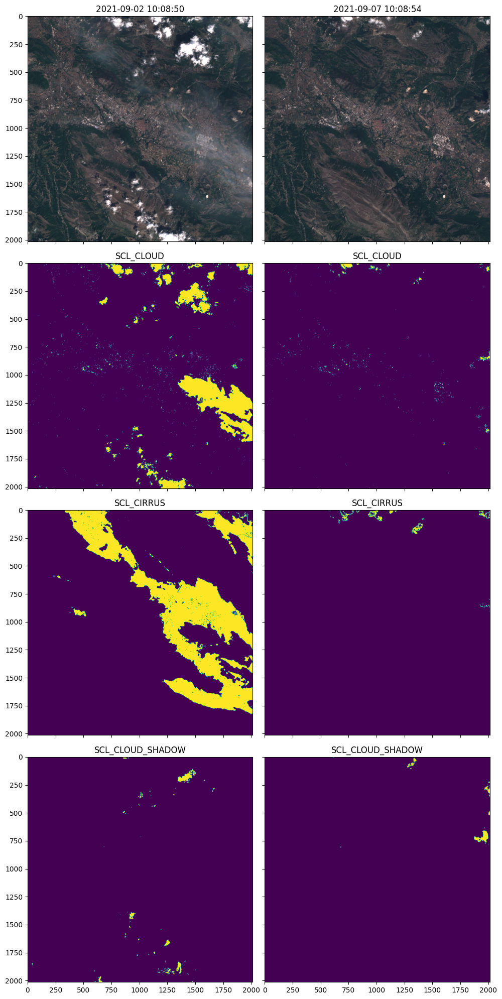

In [18]:
n_timestamps = len(eop.timestamp)
_, axes = plt.subplots(ncols=2, nrows=4, figsize=(10, 20), sharex=True, sharey=True)

for t_idx, timestamp in enumerate(eop.timestamp):
    axes[0][t_idx].imshow(np.clip(2.5 * eop.data["BANDS"][t_idx][..., [2, 1, 0]], 0, 1))
    axes[0][t_idx].set_title(eop.timestamp[t_idx])
    axes[1][t_idx].imshow(eop.mask["SCL_CLOUD"][t_idx][..., 0], vmin=0, vmax=1)
    axes[1][t_idx].set_title("SCL_CLOUD")
    axes[2][t_idx].imshow(eop.mask["SCL_CIRRUS"][t_idx][..., 0], vmin=0, vmax=1)
    axes[2][t_idx].set_title("SCL_CIRRUS")
    axes[3][t_idx].imshow(eop.mask["SCL_CLOUD_SHADOW"][t_idx][..., 0], vmin=0, vmax=1)
    axes[3][t_idx].set_title("SCL_CLOUD_SHADOW")

plt.tight_layout()

### (Optional) Filter by valid data

Depending on the location and time interval selected, no data can be available. This task removes the time-frames which have no data.

The same task can be used to filter by cloud coverage. Simply create a counter-part of the `full_valid_data` method with the desired threshold, and adapt the `SimpleFilterTask` to use the cloud mask and the newly created method. 

In [19]:
def full_valid_data(array: np.array) -> bool:
    return np.mean(array) == 1.0


filter_task = SimpleFilterTask((FeatureType.MASK, "dataMask"), full_valid_data)

In [20]:
eop = filter_task(eop)

In [21]:
eop

EOPatch(
  data={
    BANDS: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float32)
    sunZenithAngles: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD_SHADOW: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    dataMask: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=bool)
  }
  meta_info={
    maxcc: 0.7
    size_x: 2014
    size_y: 2014
    time_difference: 10800.0
    time_interval: '..'
  }
  bbox=BBox(((357890.0, 4679580.0), (378030.0, 4699720.0)), crs=CRS('32633'))
  timestamp=[datetime.datetime(2021, 9, 2, 10, 8, 50), datetime.datetime(2021, 9, 7, 10, 8, 54)]
)

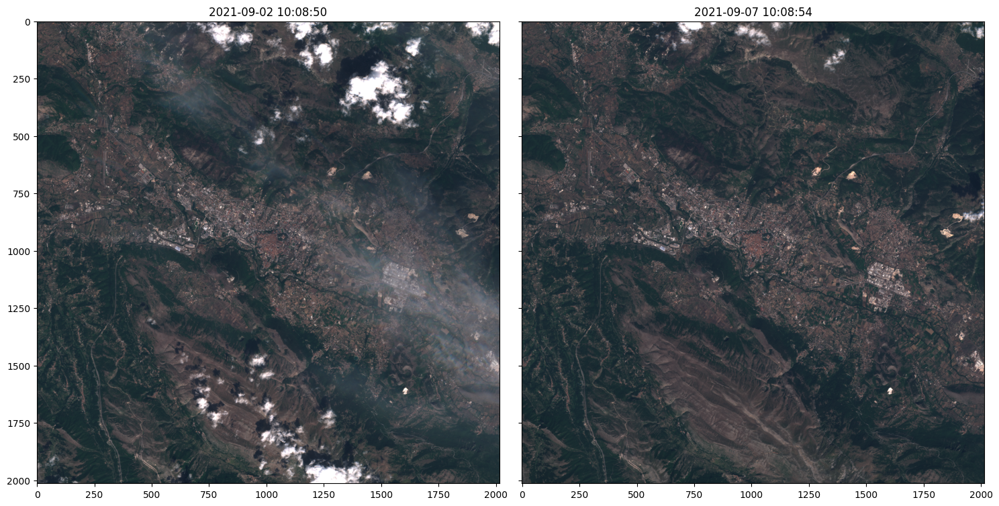

In [22]:
n_timestamps = len(eop.timestamp)
_, axes = plt.subplots(ncols=2, nrows=1, figsize=(15, 15), sharex=True, sharey=True)

for t_idx, timestamp in enumerate(eop.timestamp):
    axes[t_idx].imshow(np.clip(2.5 * eop.data["BANDS"][t_idx][..., [2, 1, 0]], 0, 1))
    axes[t_idx].set_title(eop.timestamp[t_idx])

plt.tight_layout()

<a name="metadata-download"></a>
## 2. Metadata Download 

Download the metadata necessary to compute radiance values. Such metadata consists of the solar irradiance per band, and the Earth-Sun distance.

In [23]:
add_meta_task = AddMetadataTask(config=sh_config)

In [24]:
eop = add_meta_task(eop)

In [25]:
# check result:
eop

EOPatch(
  data={
    BANDS: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float32)
    sunZenithAngles: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD_SHADOW: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    dataMask: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=bool)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B08: numpy.ndarray(shape=(2, 1), dtype=float64)
  }
  meta_info={
    maxcc: 0.7
    size_x: 2014
 

C:\Users\carlos.colladocapel\AppData\Local\Temp\ipykernel_28932\1309170822.py:5: MatplotlibDeprecationWarning: The plot_date function was deprecated in Matplotlib 3.9 and will be removed in 3.11. Use plot instead.
  ax.plot_date(


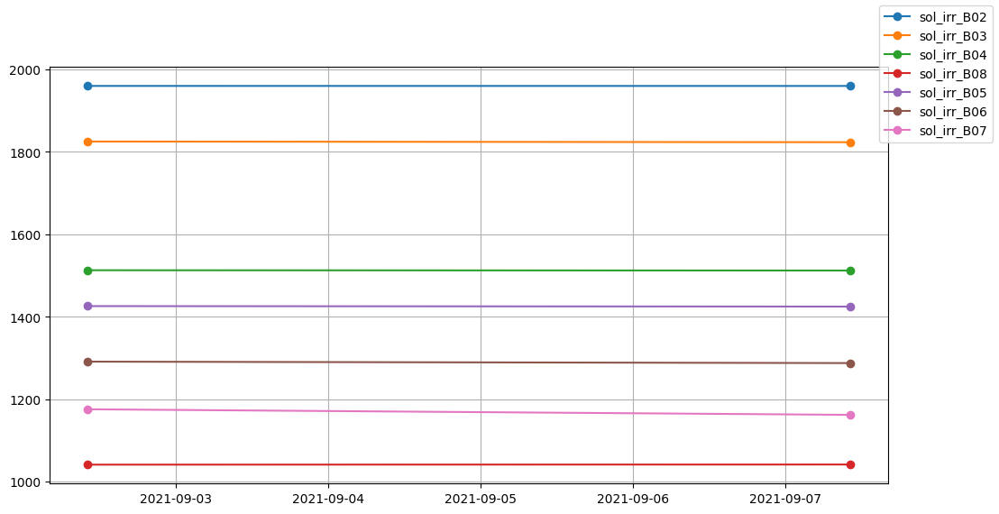

In [26]:
# plot sol_irr values for each band:

fig, ax = plt.subplots(figsize=(12, 6))
for band in S2_BANDS:
    ax.plot_date(
        x=eop.timestamp,
        y=eop.scalar[f"sol_irr_{band}"],
        linestyle="solid",
        label=f"sol_irr_{band}",
    )
fig.legend()
ax.grid()

In [27]:
eop['data']['sunZenithAngles'].shape

(2, 2014, 2014, 1)

<a name="radiances"></a>
## 3. Compute radiances

Radiances are computed from the original reflectance values. The following processing steps, e.g. SNR simulation and PSF filtering, are valid if applied to radiances.

In [28]:
radiance_task = CalculateRadianceTask(
    (FeatureType.DATA, "BANDS"), (FeatureType.DATA, "BANDS-RAD")
)

In [29]:
eop = radiance_task(eop)

eop

EOPatch(
  data={
    BANDS: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float32)
    BANDS-RAD: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float64)
    sunZenithAngles: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD_SHADOW: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    dataMask: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=bool)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B08: numpy.ndarray(shape=(2, 

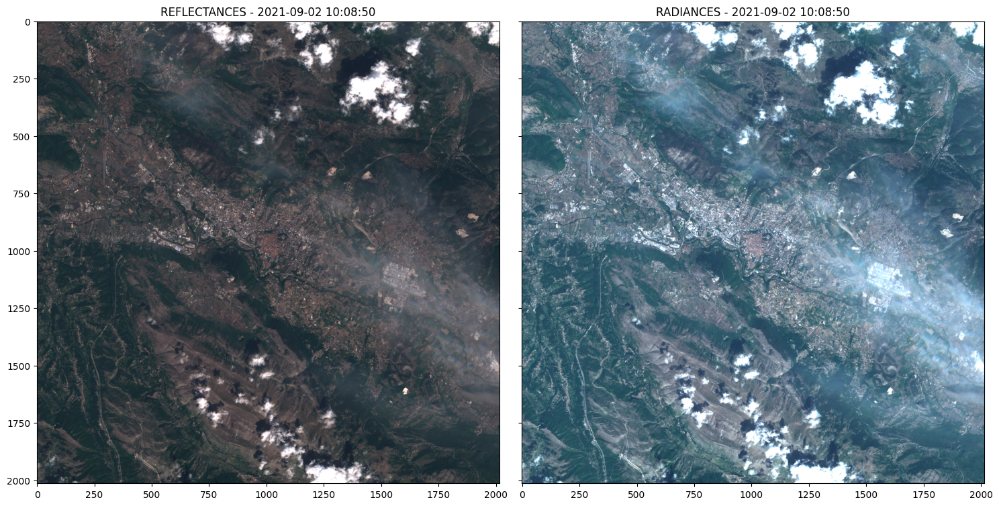

In [30]:
t_idx = 0
_, axes = plt.subplots(ncols=2, nrows=1, figsize=(15, 15), sharex=True, sharey=True)

axes[0].imshow(np.clip(2.5 * eop.data["BANDS"][t_idx][..., [2, 1, 0]], 0, 1))
axes[0].set_title(f"REFLECTANCES - {eop.timestamp[t_idx]}")

axes[1].imshow(np.clip(eop.data["BANDS-RAD"][t_idx][..., [2, 1, 0]] / 100, 0, 1))
axes[1].set_title(f"RADIANCES - {eop.timestamp[t_idx]}")

plt.tight_layout()

<a name="pan-band"></a>
## 4. Add pan-chromatic band

Compute a pan-chromatic band using a weighted linear combination of the input bands. The pan-chromatic band is inserted at index 3, in line with the acquisition order of the Φ-sat-2 payload.

In [31]:
add_pan_task = AddPANBandTask(
    (FeatureType.DATA, "BANDS-RAD"), (FeatureType.DATA, "BANDS-RAD-PAN")
)

In [32]:
eop = add_pan_task(eop)

eop

EOPatch(
  data={
    BANDS: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float32)
    BANDS-RAD: numpy.ndarray(shape=(2, 2014, 2014, 7), dtype=float64)
    BANDS-RAD-PAN: numpy.ndarray(shape=(2, 2014, 2014, 8), dtype=float64)
    sunZenithAngles: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    SCL_CLOUD_SHADOW: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=uint8)
    dataMask: numpy.ndarray(shape=(2, 2014, 2014, 1), dtype=bool)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndar

<a name="resampling"></a>
## 5. Spatial Resampling 

Spatially resample the original Sentinel-2 pixel size of 10 m to Φ-sat-2 pixel size of 4.75 m.

In [33]:
features_to_resize = {
    FeatureType.DATA: ["BANDS-RAD-PAN", "sunZenithAngles"],
    FeatureType.MASK: [
        "SCL_CLOUD",
        "SCL_CIRRUS",
        "SCL_CLOUD_SHADOW",
        "dataMask",
    ],
}

In [34]:
NEW_SIZE = (int(BBOX_SIZE / PHISAT2_RESOLUTION), int(BBOX_SIZE / PHISAT2_RESOLUTION))

In [35]:
# covert dataMask to uint8
casting_task = MapFeatureTask(
    (FeatureType.MASK, "dataMask"), (FeatureType.MASK, "dataMask"), np.uint8
)

In [36]:
eop = casting_task(eop)

In [37]:
resize_task_list = []

for feature_type in tqdm(features_to_resize.keys()):
    for feature in tqdm(features_to_resize[feature_type]):
        resize_task_list.append(
            MapFeatureTask(
                (feature_type, feature),
                (feature_type, f"{feature}_RES"),
                resize_images,
                new_size=NEW_SIZE,
                resize_method="nearest",
            )
        )
        eop = resize_task_list[-1](eop)

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

Visualise resampled bands. Note the size of the resampled arrays.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0003708228841423988..8.27861572265625].


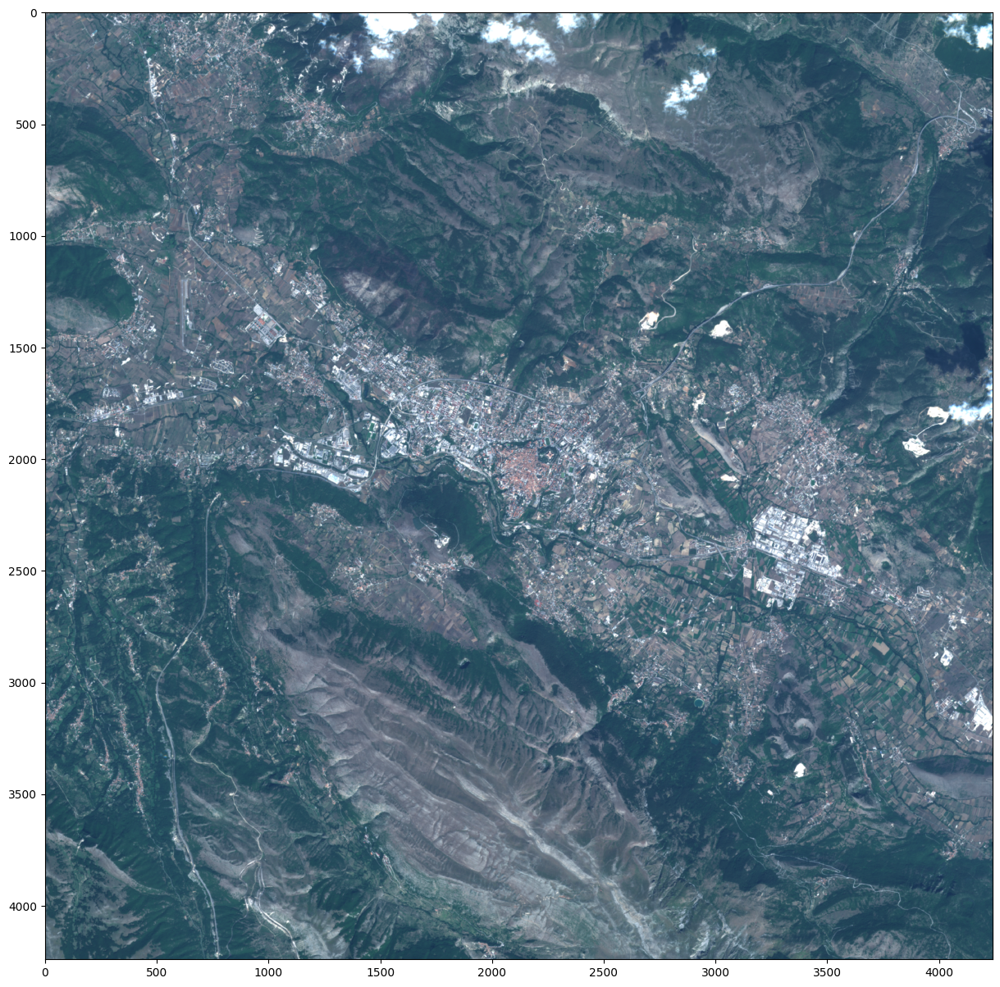

In [38]:
t_idx = 1
fig, axs = plt.subplots(figsize=(15, 15))
axs.imshow(eop.data["BANDS-RAD-PAN_RES"][t_idx][..., [2, 1, 0]] / 100);

### Remove unnecessary features

This step removes from memory arrays that are no longer needed.

In [39]:
remove_feature_task1 = RemoveFeatureTask(
    [
        (FeatureType.DATA, "BANDS"),
        (FeatureType.DATA, "BANDS-RAD"),
        (FeatureType.DATA, "BANDS-RAD-PAN"),
        (FeatureType.DATA, "sunZenithAngles"),
        (FeatureType.MASK, "SCL_CLOUD"),
        (FeatureType.MASK, "SCL_CLOUD_SHADOW"),
        (FeatureType.MASK, "SCL_CIRRUS"),
        (FeatureType.MASK, "dataMask"),
    ]
)

In [40]:
eop = remove_feature_task1(eop)

eop

EOPatch(
  data={
    BANDS-RAD-PAN_RES: numpy.ndarray(shape=(2, 4240, 4240, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B08: numpy.ndarray(shape=(2, 1), dtype=float64)
  }
  meta_info={


<a name="misalignment"></a>
## 6. Band misalignment 

The simulation of three processing levels is supported, namely L1A, L1B and L1C. L1A differs in the band misalignment process compared to L1B and L1C, with L1B and L1C displaying less misalignment compared to L1A.

L1A processing level:
 
 * define a constant with shifts wrt reference Φ-sat-2 B6 band `np.array([0,1.105,1.046,0.943,0.837,0.717,0.55,0.44,])`;
 * draw random shifts from N(0.0, 0.4) `np.random.normal(0.0, 0.4, size=(8,))`;
 * calculate the shift vector magnitudes by adding the random and constant shifts;
 * draw random angles fi from (0 - 2Pi) for each band;
 * multiply the shifts to the random angle vector for each band;
 * accummulate shifts accross bands;
 * apply the [`cv2.warpAffine`](https://docs.opencv.org/3.4/da/d54/group__imgproc__transform.html#ga0203d9ee5fcd28d40dbc4a1ea4451983) method looping  through the channels, and applying the random shifts computed above
   * use 0 as filling value at the border;
   * use Nearest Neighboord interpolation to avoid any additional smoothing at this stage.

L1B/L1C processing levels:
 * draw an amplitude value following a normal distribution of N(0,1) over land and N(0,6) over a full ocean surface scene. If the scene contained both land/sea, N(0,1) is used by default. The possibility to use N(0,6) should be a user-defined parametrization;
 * draw a fully random angle from 0 – 2pi;
 * compute the associated X and Y from the amplitude/angle;
 * apply this procedure independently for all bands except for the Red band, which is considered as the reference band.
 

In [41]:
band_shift_task = BandMisalignmentTask(
    (FeatureType.DATA, "BANDS-RAD-PAN_RES"),
    (FeatureType.DATA, "BANDS-RAD-PAN_SHIFTED"),
    PROCESSING_LEVEL,
    std_sea=6,
    interpolation_method=cv2.INTER_NEAREST,
)

In [42]:
eop = band_shift_task(eop)

# check result
eop

EOPatch(
  data={
    BANDS-RAD-PAN_RES: numpy.ndarray(shape=(2, 4240, 4240, 8), dtype=float64)
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4240, 4240, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float

In [43]:
# With Nearest Neighbour interpolation, the effective shifts applied are rounded to integer values.
for shifts in eop.meta_info["Shifts"].values():
    print(np.round(shifts))

[[ 0. -0.]
 [ 0. -0.]
 [ 0.  0.]
 [-0.  0.]
 [-0.  0.]
 [ 1. -0.]
 [ 0. -0.]
 [-1. -0.]]
[[ 0.  0.]
 [-0. -0.]
 [ 0.  0.]
 [ 0.  1.]
 [-0.  0.]
 [-0. -1.]
 [-0. -1.]
 [-0.  1.]]


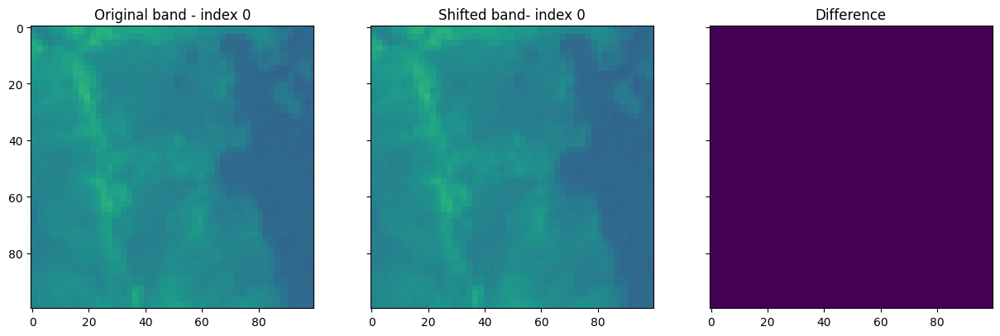

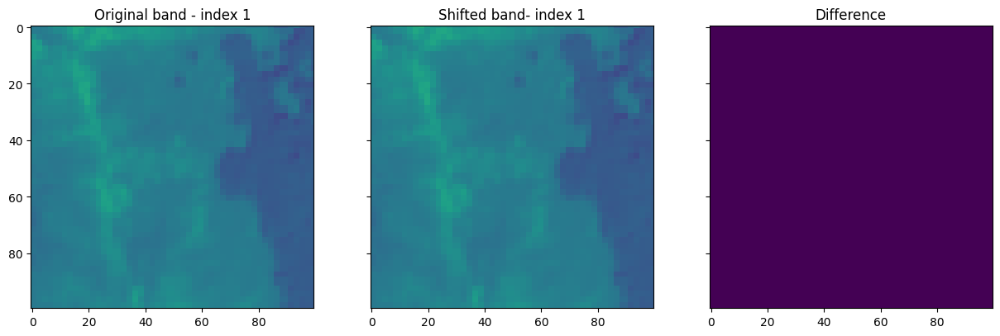

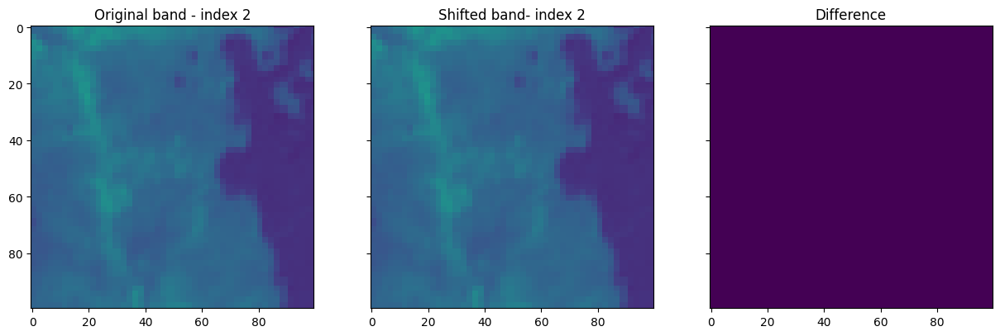

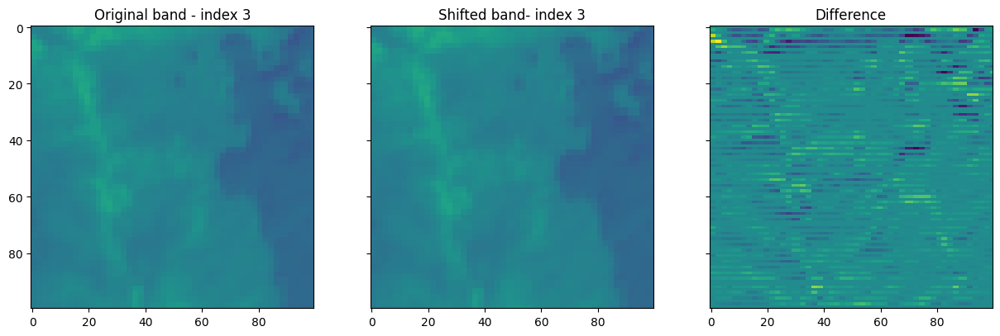

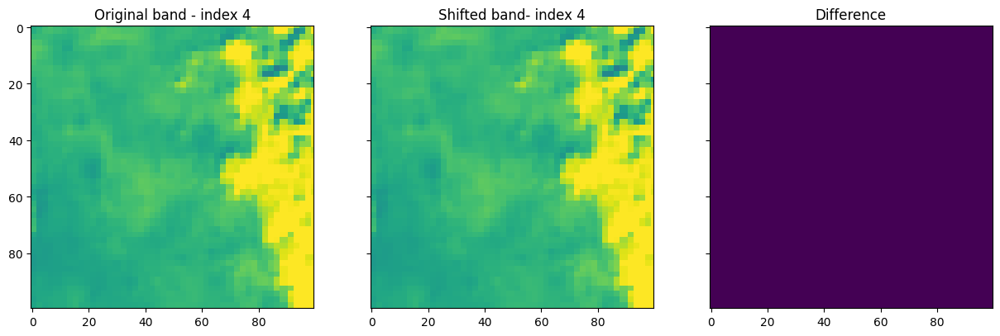

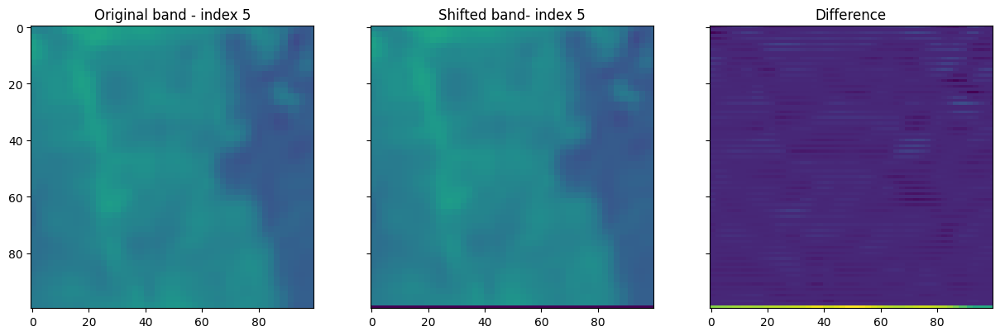

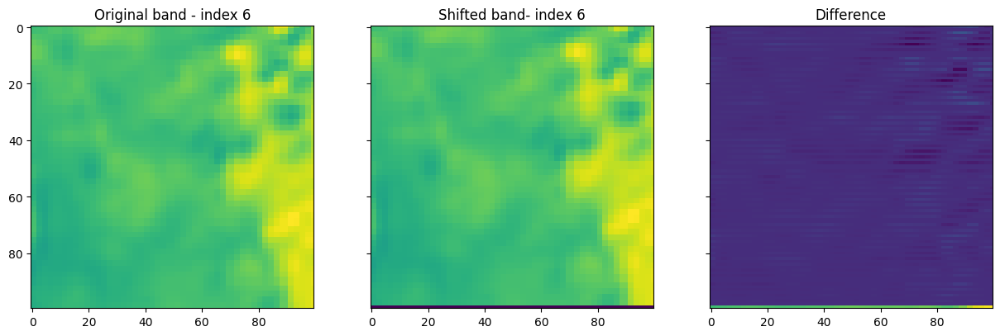

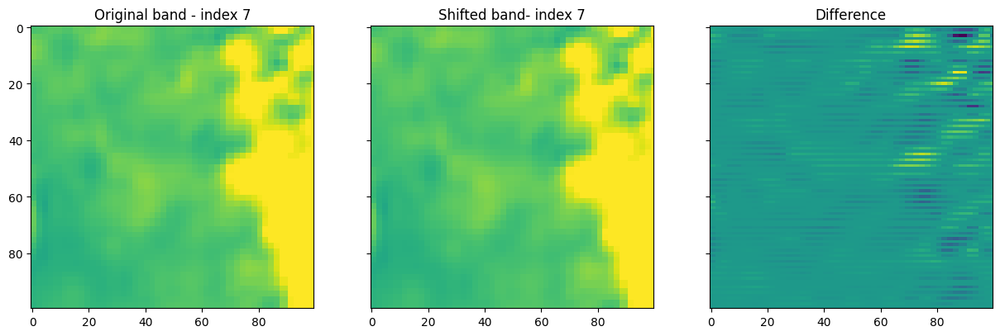

In [44]:
# plot the shift in bands
ts_idx = 1
num_bands = 8

for b_idx in range(0, num_bands):
    _, ax = plt.subplots(ncols=3, nrows=1, figsize=(15, 15), sharex=True, sharey=True)
    ax[0].imshow(
        eop.data["BANDS-RAD-PAN_RES"][ts_idx][-100:, :100, b_idx] / 100, vmin=0, vmax=1
    )
    ax[0].set_title(f"Original band - index {b_idx}")

    ax[1].imshow(
        eop.data["BANDS-RAD-PAN_SHIFTED"][ts_idx][-100:, :100, b_idx] / 100,
        vmin=0,
        vmax=1,
    )
    ax[1].set_title(f"Shifted band- index {b_idx}")

    diff = (
        eop.data["BANDS-RAD-PAN_RES"][ts_idx][-100:, :100, b_idx]
        - eop.data["BANDS-RAD-PAN_SHIFTED"][ts_idx][-100:, :100, b_idx]
    )
    ax[2].imshow(diff)
    ax[2].set_title("Difference")

In [45]:
remove_feature_task2 = RemoveFeatureTask([(FeatureType.DATA, "BANDS-RAD-PAN_RES")])

In [46]:
eop = remove_feature_task2(eop)
eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4240, 4240, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4240, 4240, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B08: numpy.ndarray(shape=(2, 1), dtype=float64)
  }
  meta_inf

Crop the image to contain only valid data after band misalignment

In [47]:
crop_task = CropTask(
    features_to_crop=[
        (FeatureType.DATA, "BANDS-RAD-PAN_SHIFTED"),
        (FeatureType.DATA, "sunZenithAngles_RES"),
        (FeatureType.MASK, "SCL_CLOUD_RES"),
        (FeatureType.MASK, "SCL_CLOUD_SHADOW_RES"),
        (FeatureType.MASK, "SCL_CIRRUS_RES"),
        (FeatureType.MASK, "dataMask_RES"),
    ]
)

In [48]:
eop = crop_task(eop)

eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B08: numpy.ndarray(shape=(2, 1), dtype=float64)
  }
  meta_inf

<a name="snr"></a>
## 7. Noise Calculation

This step simulates noise according to the signal-toNoise (SNR) specifications of the optical system.

A compiled executable will perform the SNR and PSF calculation. 

Executables for the following Operating Systems (OSs) have been compiled:

 * Unix, `phisat2_unix.bin`
 * Windows, `phisat2_win.bin`
 * MacOS, `phisat2_osx-arm64.bin` for ARM chips, `phisat2_osx-x86_64.bin` for Intel chips
 
Download the suitable binary for your OS from this [link](https://cloud.sinergise.com/s/g88Ns32rXB3AT6i). 

Once downloaded, allow the operating system to run the file and make it executable (e.g. `chmod a+x phisat2_unix.bin`). Then set the path to the executable in the cell below.

In [49]:
EXEC_PATH = "executables/phisat2_win.bin"

In [50]:
snr_task = PhisatCalculationTask(
    input_feature=(FeatureType.DATA, "BANDS-RAD-PAN_SHIFTED"),
    output_feature=(FeatureType.DATA, "L_out_RES"),
    executable=EXEC_PATH,
    calculation="SNR",
)

In [51]:
eop = snr_task.execute(eop)

# check (can take > 40s to run)
eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_RES: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
    

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0003708228841423988..8.27861572265625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.002147167913967921..8.290537011441957].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [2.1189581644875943e-08..6.337182852597778].


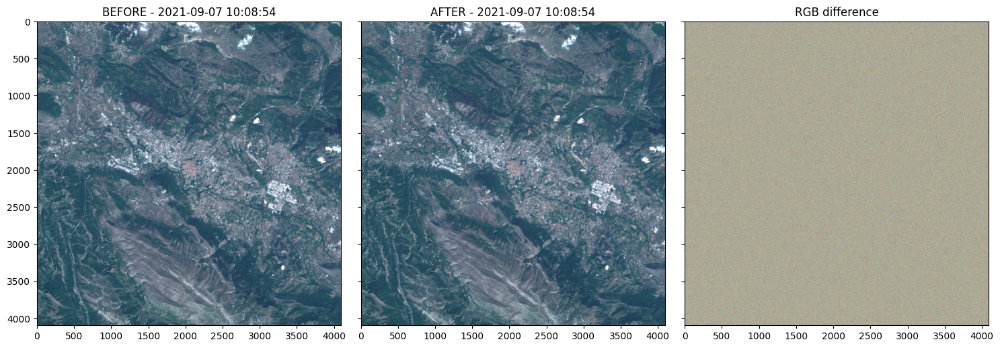

In [52]:
# plot differences due to noise
tidx = 1

_, axes = plt.subplots(ncols=3, nrows=1, figsize=(15, 15), sharex=True, sharey=True)

axes[0].imshow(eop.data["BANDS-RAD-PAN_SHIFTED"][t_idx][..., [2, 1, 0]] / 100.0)
axes[0].set_title(f"BEFORE - {timestamp}")
axes[1].imshow(eop.data["L_out_RES"][t_idx][..., [2, 1, 0]] / 100.0)
axes[1].set_title(f"AFTER - {timestamp}")
axes[2].imshow(
    np.abs(
        eop.data["L_out_RES"][t_idx][..., [2, 1, 0]]
        - eop.data["BANDS-RAD-PAN_SHIFTED"][t_idx][..., [2, 1, 0]]
    )
)
axes[2].set_title("RGB difference")
plt.tight_layout()

<a name="psf"></a>
## 8. Simulate Point Spread Function (PSF) Filtering

Step that simulates loss of signal due to limited bandwidth of the Module Transfer Function (MTF), which is equivalent to simulate the Point Spread Function (PSF) for the entire system (imager and platform).

The same executable as for SNR is used. If you have not downloaded it already, do so for your OS from this [link](https://cloud.sinergise.com/s/g88Ns32rXB3AT6i). Once downloaded, allow the operating system to run the file and make it executable (e.g. `chmod a+x phisat2_unix.bin`). Then set the path to the executable in the cell below.

In [53]:
psf_filter_task = PhisatCalculationTask(
    input_feature=(FeatureType.DATA, "L_out_RES"),
    output_feature=(FeatureType.DATA, "L_out_PSF"),
    executable=EXEC_PATH,
    calculation="PSF",
)

In [54]:
eop = psf_filter_task(eop)

# check result:
eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_PSF: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_RES: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=flo

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.10534477047080422..8.690531437713215].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.12445646485577366..7.222312766051861].


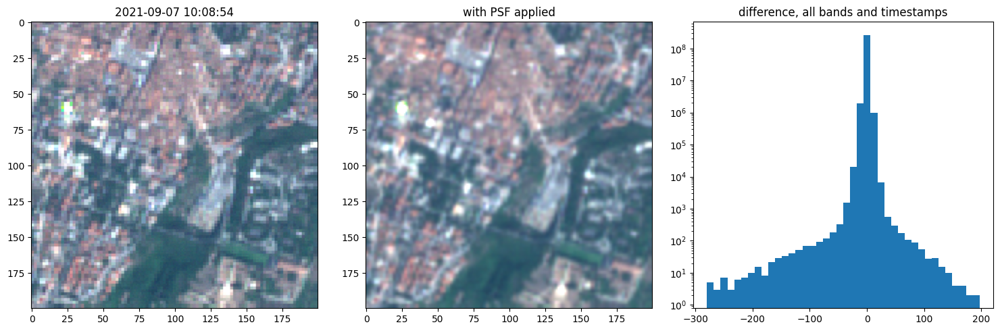

In [55]:
# visualize part of EOPatch before/after applying PSF kernel

n_timestamps = len(eop.timestamp)
fig, axes = plt.subplots(ncols=3, nrows=1, figsize=(15, 5))

axes[0].imshow(eop.data["L_out_RES"][0][2000:2200, 2000:2200, [2, 1, 0]] / 100)
axes[0].set_title(timestamp)
axes[1].imshow(eop.data["L_out_PSF"][0][2000:2200, 2000:2200, [2, 1, 0]] / 100)
axes[1].set_title("with PSF applied")
diff = eop.data["L_out_PSF"] - eop.data["L_out_RES"]
axes[2].hist(diff.ravel(), bins=40, log=True)
axes[2].set_title("difference, all bands and timestamps")

plt.tight_layout()

In [56]:
eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_PSF: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_RES: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=flo

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.10534477047080422..8.690531437713215].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.12445646485577366..7.222312766051861].


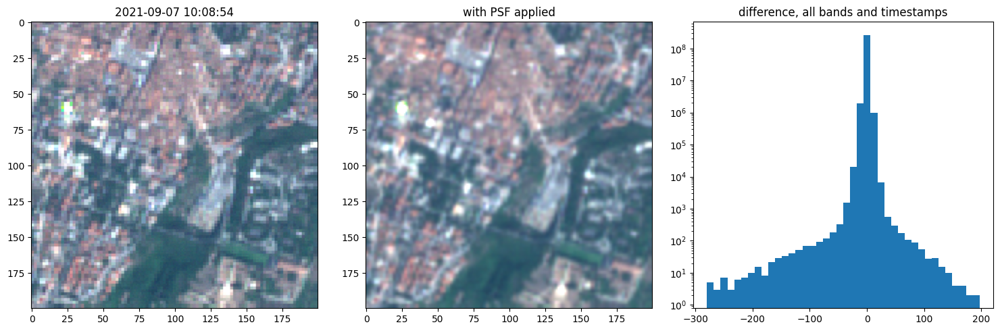

In [57]:
# visualize part of EOPatch before/after applying PSF kernel

n_timestamps = len(eop.timestamp)
fig, axes = plt.subplots(ncols=3, nrows=1, figsize=(15, 5))

axes[0].imshow(eop.data["L_out_RES"][0][2000:2200, 2000:2200, [2, 1, 0]] / 100)
axes[0].set_title(timestamp)
axes[1].imshow(eop.data["L_out_PSF"][0][2000:2200, 2000:2200, [2, 1, 0]] / 100)
axes[1].set_title("with PSF applied")
diff = eop.data["L_out_PSF"] - eop.data["L_out_RES"]
axes[2].hist(diff.ravel(), bins=40, log=True)
axes[2].set_title("difference, all bands and timestamps")

plt.tight_layout()

<a name="alternative"></a>
## 9. Alternative Noise and PSF calculation 

The `AlternativePhisatCalculationTask` allows users to input their own Signal To Noise ratios and their own Point Spread Function kernel values for addition of SNR and PSF.

In [58]:
kernel_bands = ["B1", "B2", "B3", "B0", "B7", "B4", "B5", "B6"]
psf_kernel = { band: np.random.random(size=(7,7)) for band in kernel_bands }

snr_bands = ["B02", "B03", "B04", "PAN", "B08", "B05", "B06", "B07"]
snr_values = { band: np.random.randint(20,250) for band in snr_bands }

snr_psf_task = AlternativePhisatCalculationTask(
    input_feature=(FeatureType.DATA, "BANDS-RAD-PAN_SHIFTED"),
    snr_feature=(FeatureType.DATA, "L_out_RES"),
    psf_feature=(FeatureType.DATA, "L_out_PSF"),
    snr_values=snr_values,
    psf_kernel=psf_kernel,
    l_ref=100
)

# uncomment to run
# eop = snr_psf_task(eop)

# check result:
eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_PSF: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_RES: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=flo

<a name="l1c"></a>
## 10. Compute L1C 


If the specified processing level is L1C, reflectances are computed from radiances. Otherwise, radiances are provided as output for L1A and L1B.

In [59]:
reflectance_task = CalculateReflectanceTask(
    input_feature=(FeatureType.DATA, "L_out_PSF"),
    output_feature=(FeatureType.DATA, "PHISAT2-BANDS"),
    processing_level=PROCESSING_LEVEL,
)

In [60]:
eop = reflectance_task(eop)

eop

EOPatch(
  data={
    BANDS-RAD-PAN_SHIFTED: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_PSF: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    L_out_RES: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    PHISAT2-BANDS: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2,

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0814287710200254..8.079814190057455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.07682183775605807..5.887733943137902].


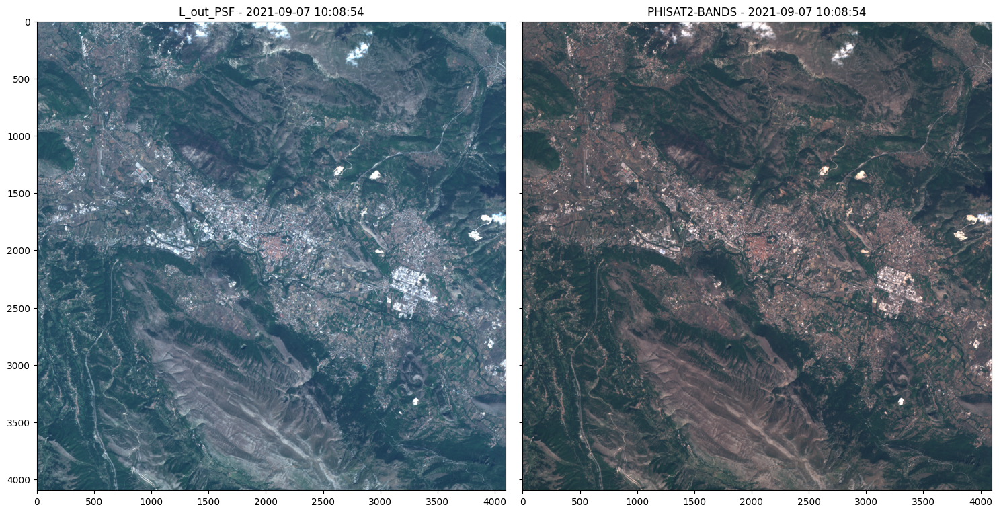

In [61]:
# plot difference dub to radiance to refelectance conversion if applied
t_idx = 1
viz_factor = 3.5 if PROCESSING_LEVEL.value == ProcessingLevels.L1C.value else 0.01
_, axes = plt.subplots(ncols=2, nrows=1, figsize=(15, 15), sharex=True, sharey=True)

axes[0].imshow(eop.data["L_out_PSF"][t_idx][..., [2, 1, 0]] / 100.0)
axes[0].set_title(f"L_out_PSF - {timestamp}")
axes[1].imshow(eop.data["PHISAT2-BANDS"][t_idx][..., [2, 1, 0]] * viz_factor)
axes[1].set_title(f"PHISAT2-BANDS - {timestamp}")
plt.tight_layout()

In [62]:
remove_feature_task3 = RemoveFeatureTask(
    [
        (FeatureType.DATA, "BANDS-RAD-PAN_SHIFTED"),
        (FeatureType.DATA, "L_out_PSF"),
        (FeatureType.DATA, "L_out_RES"),
    ]
)

In [63]:
eop = remove_feature_task3(eop)

<a name="gridding"></a>
## 11. Gridding 

On board of Φ-sat-2 the images covering the swath width will be split into smaller patches for computational processing. For creation of the training dataset, non-overlapping image patches of size 256x256 are created. When testing your algorithm, the image patches should possibly overlap to remove edge artefacts. 

Change the parameters in the cell below to modify the size of the image patches and their overlap.

In [64]:
CELL_SIZE = 256
GRID_OVERLAP = 0.0

The gridding task works for a single timestamp at a time. If you needed to grid multiple timeframes, you need to have a task for each timeframe to grid and export to Tiff.

In [65]:
time_index = 0

FEATURE_NAMES = [
    (FeatureType.DATA, "PHISAT2-BANDS"),
    (FeatureType.MASK, "SCL_CIRRUS_RES"),
    (FeatureType.MASK, "SCL_CLOUD_RES"),
    (FeatureType.MASK, "SCL_CLOUD_SHADOW_RES"),
    (FeatureType.MASK, "dataMask_RES"),
]

gridding_tasks = []

for feature_type, feature_name in FEATURE_NAMES:
    gridding_tasks.append(
        GriddingTask(
            (feature_type, feature_name),
            (feature_type, f"{feature_name}-GRID_{time_index}"),
            (FeatureType.VECTOR_TIMELESS, f"{feature_name}-GRID_{time_index}"),
            size=CELL_SIZE,
            overlap=GRID_OVERLAP,
            resolution=PHISAT2_RESOLUTION,
            time_index=time_index,
        )
    )

In [66]:
eop = gridding_tasks[0](eop)

In [67]:
eop

EOPatch(
  data={
    PHISAT2-BANDS: numpy.ndarray(shape=(2, 4096, 4096, 8), dtype=float64)
    PHISAT2-BANDS-GRID_0: numpy.ndarray(shape=(256, 256, 256, 8), dtype=float64)
    sunZenithAngles_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=float32)
  }
  mask={
    SCL_CIRRUS_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    SCL_CLOUD_SHADOW_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
    dataMask_RES: numpy.ndarray(shape=(2, 4096, 4096, 1), dtype=uint8)
  }
  scalar={
    earth_sun_dist: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B02: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B03: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B04: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B05: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B06: numpy.ndarray(shape=(2, 1), dtype=float64)
    sol_irr_B07: numpy.ndarray(shape=(2, 1), dtype=float64)
 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.10583138135947986..1.0952968213481116].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.11164661996530545..1.1991360403299716].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.14414839841271512..1.2860945089314364].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.11654735258909427..1.2372437547556299].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.12675746877354982..2.122844951560945].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.10938559354629389..1.1024448891325507].


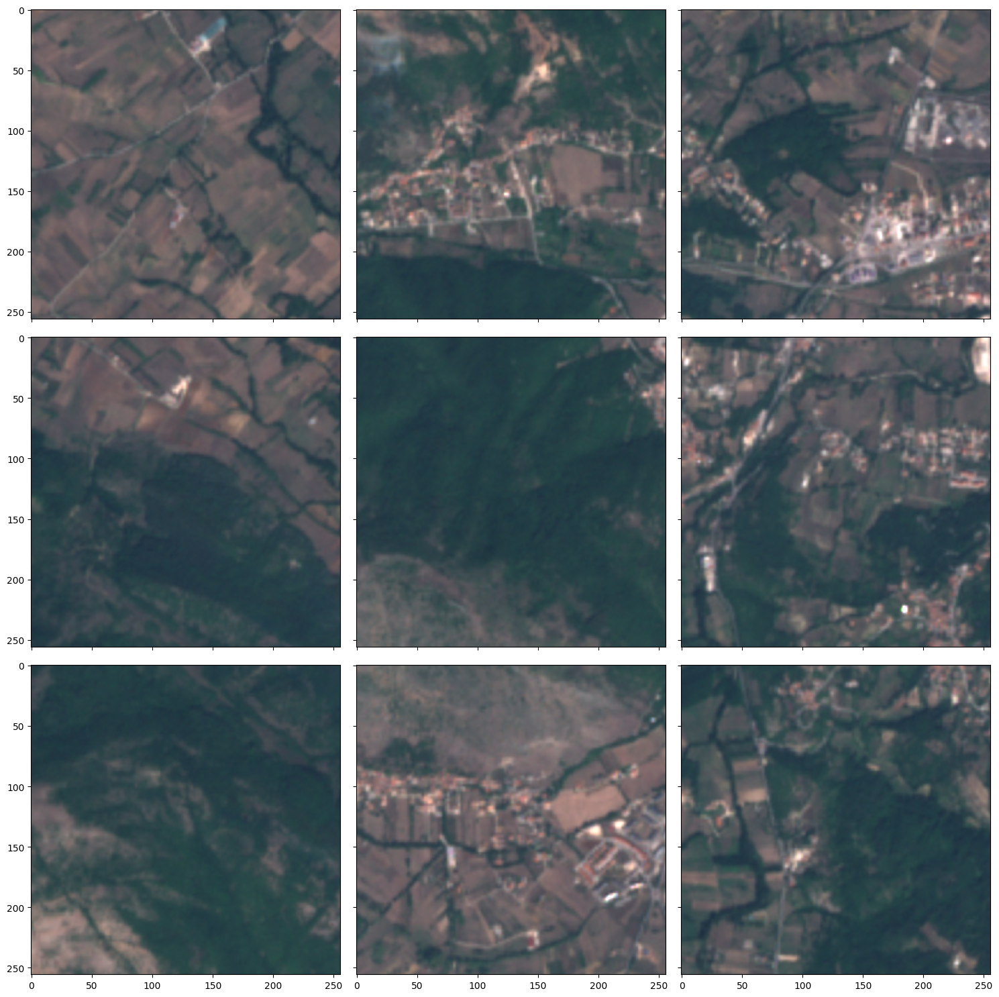

In [68]:
NSAMPLES = 9
_, axs = plt.subplots(
    figsize=(15, 15), ncols=3, nrows=NSAMPLES // 3, sharex=True, sharey=True
)
for nsample in range(NSAMPLES):
    axs[nsample % 3][nsample // 3].imshow(
        eop.data[f"PHISAT2-BANDS-GRID_{time_index}"][nsample][..., [2, 1, 0]]
        * viz_factor
    )
plt.tight_layout()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.07682183775605807..5.887733943137902].


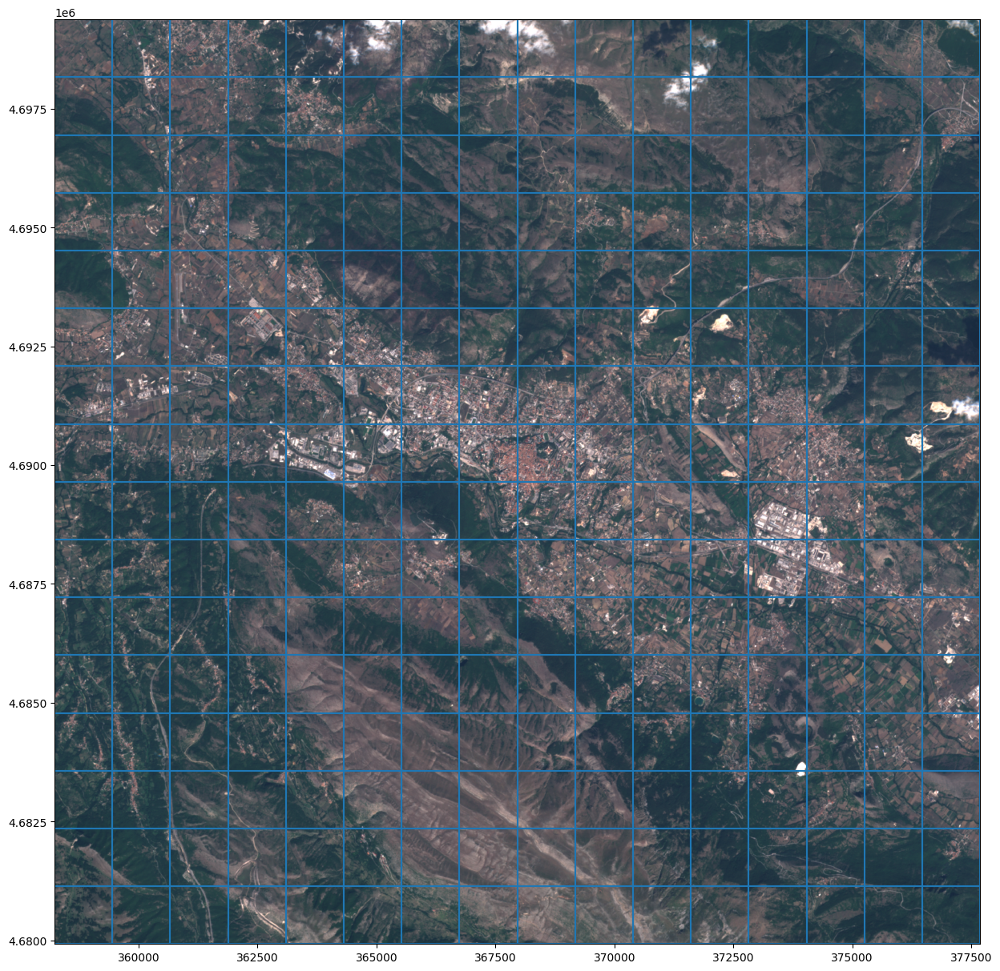

In [69]:
# show resulting grid

fig, axs = plt.subplots(figsize=(15, 15))
axs.imshow(
    eop.data["PHISAT2-BANDS"][1][..., [2, 1, 0]] * viz_factor, extent=get_extent(eop)
)
eop.vector_timeless[f"PHISAT2-BANDS-GRID_{time_index}"].boundary.plot(ax=axs);

<a name="export"></a>
## 12. Export to Tiff
 
Creates tiffs for a single timestamp. The simulated bands along with the cloud, cloud shadow, and cirrus mask are exported as tiff files. These files can be visualised and further analysed into any GIS software, such as QGis.

The format of the tiff filename is as follows:

``{utm_easting_centroid}-{utm_northing_centroid}_{epsg_crs}_{feature}_{datetime}_{cell_number}``

In [70]:
# create a folder for output tiffs
os.makedirs("tiff_folder", exist_ok=True)

In [71]:
export_tiff_tasks = []

for feature_type, feature_name in FEATURE_NAMES:
    export_tiff_tasks.append(
        ExportGridToTiff(
            data_stack_feature=(feature_type, f"{feature_name}-GRID_{time_index}"),
            grid_feature=(
                FeatureType.VECTOR_TIMELESS,
                f"{feature_name}-GRID_{time_index}",
            ),
            out_folder="./tiff_folder",
            time_index=time_index,
        )
    )

In [72]:
eop = export_tiff_tasks[0](eop)

In [73]:
# check result:
os.listdir("tiff_folder")[:10]

['367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_000.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_001.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_002.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_003.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_004.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_005.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_006.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_007.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_008.tiff',
 '367960-4689650_32633_PHISAT2-BANDS-GRID_0_2021-09-02T10-08-50_009.tiff']

<a name="workflow"></a>
## 13. Create Workflow 

The tasks constituting the simulation workflow can be sequentially connected to create an EOWorkflow, which allows parallel execution over several AOIs. Read more about `eo-learn` workflows and parallel execution [here](https://eo-learn.readthedocs.io/en/latest/examples/core/CoreOverview.html#EONode-and-EOWorkflow). 

In [74]:
raise ValueError("Stopping execution as a safety measure.")

ValueError: Stopping execution as a safety measure.

In [ ]:
nodes = linearly_connect_tasks(
    scl_download_task,
    scl_cloud_task,
    input_task,
    # filter_task,  # Uncomment this if you want to filter by 100% of valid data
    add_meta_task,
    radiance_task,
    add_pan_task,
    casting_task,
    *resize_task_list,
    remove_feature_task1,
    band_shift_task,
    remove_feature_task2,
    crop_task,
    snr_task,
    psf_filter_task,
    reflectance_task,
    remove_feature_task3,
    *gridding_tasks,
    *export_tiff_tasks,
)
workflow = EOWorkflow(nodes)

In [ ]:
# This line repeats the simulation as done in the cells above
results = workflow.execute({nodes[0]: {"bbox": bbox, "time_interval": time_interval}})

<a name="core-dataset"></a>
## 14. Core Dataset

To get you started with your AI application at-the-edge, we simulated Φ-sat-2 imagery for around 490 location on Earth. The workflow as defined above was used to simulate L1C products for the locations and dates as specified in the provided `phisat2-locations.gpkg` file. The code below was used to generate such images. 

The locations and acquisition times seek to match the ones for the PRISMA images utilized in the IMAGIN-e track of the challenge. The information about the time difference from the PRISMA acquisition time is stored in the GeoDataFrame, as well as the `maxcc` of Sentinel-2 image and the overlap between the Φ-sat-2 bounding box and the geometry of the Sentinel-2 image. The dataframe also contains the name of the coresponding PRISMA image `prisma_name`, in case you wanted to cross-reference the datasets.

We suggest you to prepare a similar dataframe with dates and locations suitable for your application and use the code below to simulate Φ-sat-2 imagery. 

For the locations provided we suggest you download directly the provided tiff files, unless you want to tweak the simulation workflow. The name of the zip archive containing the image patches can be found in the `zipfile` column, so you can retrieve from storage only the simulated locations of interest. The zipfiles are available on cloudferro on the following public bucket 

`https://s3.waw2-1.cloudferro.com/swift/v1/AUTH_afccea586afd4ef3bb11fe37dd1ddfbf/OrbitalAI_Data/`, 

and you can download any file by appending hte zip archive name, e.g. 

[`https://s3.waw2-1.cloudferro.com/swift/v1/AUTH_afccea586afd4ef3bb11fe37dd1ddfbf/OrbitalAI_Data/335040-5955400_32618_2019-10-12T16-28-28.zip`](https://s3.waw2-1.cloudferro.com/swift/v1/AUTH_afccea586afd4ef3bb11fe37dd1ddfbf/OrbitalAI_Data/335040-5955400_32618_2019-10-12T16-28-28.zip)

In [ ]:
phisat2_locations = gpd.read_file("phisat2-locations.gpkg")

In [ ]:
len(phisat2_locations)

489

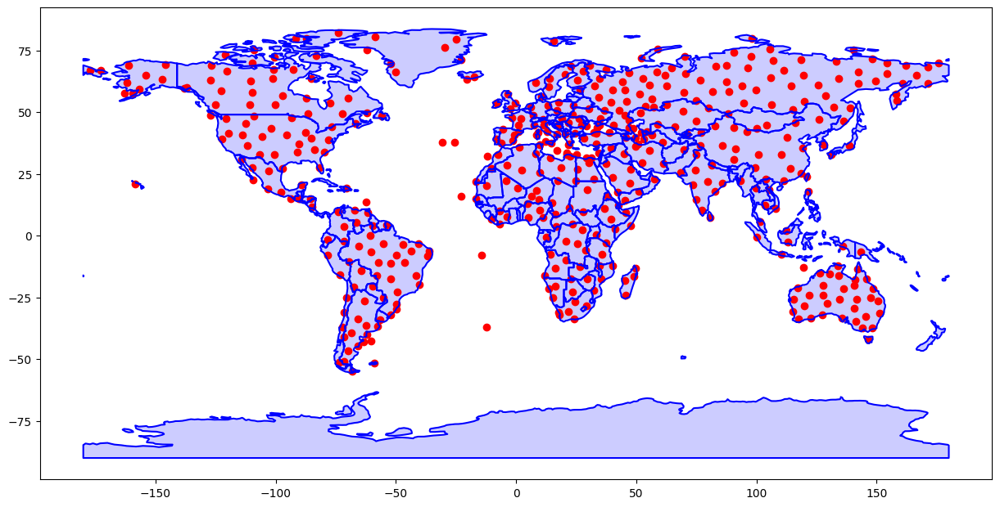

In [ ]:
fig, ax = plt.subplots(figsize=(15, 10))
WORLD_GDF.plot(ax=ax, color="b", alpha=0.2)
WORLD_GDF.boundary.plot(ax=ax, color="b")
phisat2_locations.plot(ax=ax, color="r");

In [ ]:
phisat2_locations.head(5)

,datetime_s2,intersection_ratio,cloud_cover_s2,time_difference,prisma_name,zipfile,geometry
0,2019-10-12T16:28:28,1.000000,0.30,-14,PRS_L1_STD_OFFL_20191026162600_20191026162604_...,335040-5955400_32618_2019-10-12T16-28-28.zip,POINT (-77.5 53.7212)
1,2019-11-30T15:30:28,1.000000,16.20,-7,PRS_L1_STD_OFFL_20191207152456_20191207152500_...,632700-1080910_32618_2019-11-30T15-30-13.zip,POINT (-73.79 9.77629)
2,2019-12-18T08:48:42,1.000000,28.67,-1,PRS_L1_STD_OFFL_20191219085427_20191219085431_...,539510-4571900_32636_2019-12-18T08-48-42.zip,POINT (33.472 41.2976)
3,2019-12-20T09:31:05,0.805958,3.45,-1,PRS_L1_STD_OFFL_20191221093011_20191221093015_...,495240-3696340_32634_2019-12-20T09-31-01.zip,POINT (20.9489 33.4064)
4,2019-12-26T09:50:55,1.000000,0.23,4,PRS_L1_STD_OFFL_20191222094637_20191222094641_...,688270-3825460_32633_2019-12-26T09-50-55.zip,POINT (17.052 34.5537)


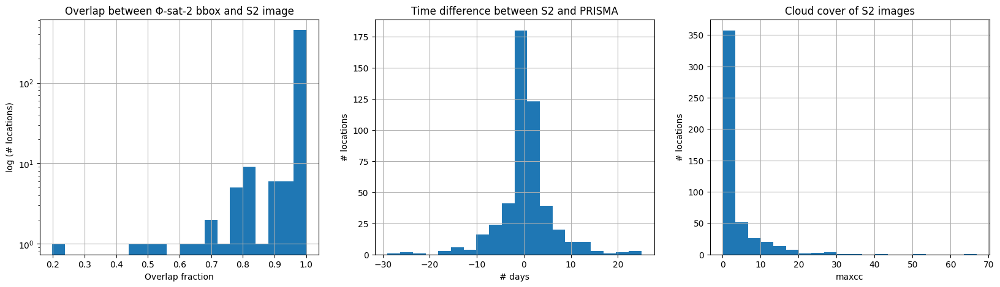

In [ ]:
fig, ax = plt.subplots(figsize=(20, 5), ncols=3)
phisat2_locations.intersection_ratio.hist(ax=ax[0], bins=20, log=True)
ax[0].set_title("Overlap between Φ-sat-2 bbox and S2 image")
ax[0].set_xlabel("Overlap fraction")
ax[0].set_ylabel("log (# locations)")

phisat2_locations.time_difference.hist(ax=ax[1], bins=20)
ax[1].set_title("Time difference between S2 and PRISMA")
ax[1].set_xlabel("# days")
ax[1].set_ylabel("# locations")

phisat2_locations.cloud_cover_s2.hist(ax=ax[2], bins=20)
ax[2].set_title("Cloud cover of S2 images")
ax[2].set_xlabel("maxcc")
ax[2].set_ylabel("# locations");

The simulation workflow can be parallelized over the locations to speed up the processing. `EOExecutor` allows to scale the processing over multiple processors/instances. For this to work we need to prepare the list of arguments for the executor, and the number of processing units to parallelize the execution over.

In [ ]:
exec_args = [
    {
        nodes[0]: {
            "bbox": get_utm_bbox(coords.y, coords.x),
            "time_interval": (atime.split("T")[0], atime.split("T")[0]),
        }
    }
    for atime, coords in zip(phisat2_locations.datetime_s2, phisat2_locations.geometry)
]

In [ ]:
exec_args[0]

{EONode(task=<eolearn.io.sentinelhub_process.SentinelHubInputTask object at 0x000002DC173A4DC0>, inputs=(), name='SentinelHubInputTask'): {'bbox': BBox(((324970.0, 5945330.0), (345110.0, 5965470.0)), crs=CRS('32618')),
  'time_interval': ('2019-10-12', '2019-10-12')}}

In [ ]:
eoexecutor = EOExecutor(workflow=workflow, execution_kwargs=exec_args, save_logs=True)

---
**Warning**: Execute the cell below with caution. It will try to access and download > 500 GB of data
---


In [ ]:
raise ValueError("Stopping execution as a safety measure.")

ValueError: Stopping execution as a safety measure.

In [ ]:
eoexecutor.run(workers=4);

  0%|          | 0/489 [00:00<?, ?it/s]